# 0. Import Libraries and Functions

In [1]:
import csv
import json
import requests
from urllib.parse import unquote

import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

import pandas as pd
import numpy as np

from IPython.display import display
from impc_api import solr_request
from tqdm import tqdm

import warnings
warnings.filterwarnings("ignore")

In [2]:
# Create helper function.
def batch_request(core, params, batch_size):
    """Calls `solr_request` multiple times with `params` to retrieve results in chunk `batch_size` rows at a time."""
    if "rows" in "params":
        print("WARN: You have specified the `params` -> `rows` value. It will be ignored, because the data is retrieved `batch_size` rows at a time.")
    # Determine the total number of rows. Note that we do not request any data (rows = 0).
    num_results, _ = solr_request(core=core, params={**params, "start": 0, "rows": 0}, silent=True)
    # Initialise everything for data retrieval.
    start = 0
    chunks = []
    # Request chunks until we have complete data.
    with tqdm(total=num_results) as pbar:  # Initialize tqdm progress bar.
        while start < num_results:
            # Update progress bar with the number of rows requested.
            pbar.update(batch_size) 
            # Request chunk. We do not need num_results anymore because it does not change.
            _, df_chunk = solr_request(core=core, params={**params, "start": start, "rows": batch_size}, silent=True)
            # Record chunk.
            chunks.append(df_chunk)
            # Increment start.
            start += batch_size
    # Prepare final dataframe.
    return pd.concat(chunks, ignore_index=True)

# 1. Download Known Body Weight Data
Two queries were used to download the DR 21.1 data. Solr cores are updated each data release, so the downloaded data could be for newer version of the data release. Please navigate [mousephenotype.org](https://www.mousephenotype.org/) for more information.

* Download all body weight data.
```
df = batch_request(
    core="experiment",
    params={
        "q": 'parameter_name:"Body weight" OR parameter_name:"Body Weight"',
        "fl": "age_in_days,data_point,life_stage_name,parameter_stable_id,specimen_id"
    },
    batch_size=10000
)
df.to_json("all_bwt_data.json", orient="records")
```
* Download all body weight data and extra column biological_sample_group.
```
df = batch_request(
    core="experiment",
    params={
        "q": 'parameter_name:"Body weight" OR parameter_name:"Body Weight"',
        "fl": "age_in_days,data_point,life_stage_name,parameter_stable_id,specimen_id,biological_sample_group"
    },
    batch_size=10000
)
df.to_json("all_bwt_data_groups.json", orient="records")
```

In [3]:
# Group by specimen_id, create the list of tuples, and sort them by age_in_days.
def reshape_df(input_df, biogroup=False):
    if not biogroup:
        groupby_list = "specimen_id"
    else:
        groupby_list = ["specimen_id", "biological_sample_group"]
    df = input_df.groupby(groupby_list).apply(
        lambda x: sorted(list(zip(x["age_in_days"], x["data_point"])), key=lambda t: t[0])
    ).reset_index(name="age_weight")
    return df

In [4]:
def calculate_max(input_tuple):
    """
    Calculate the maximum difference between consecutive elements in a specified column of a list of tuples.

    Args:
        input_tuple (list of tuples): A list where each element is a tuple containing two numeric values.

    Returns:
        float: The maximum difference between consecutive elements in the specified column.
    
    Example:
        input_tuple = [(371, 36.92), (371, 36.92), (375, 36.69), (385, 37.77), (393, 36.84)]
        result = calculate_max(input_tuple)
        # result would be 14.0 since the maximum interval difference is between 393 and 379 (393 - 379)
    """
    
    # Filter out empty or single-element tuples
    input_tuples = [t for t in input_tuple if len(t) > 1]
    
    if len(input_tuples) < 2:
        return None
        print(f"Short data: {input_tuple}")  # Return negative infinity or handle it as per your application logic
    
    difference = [input_tuples[i + 1][0] - input_tuples[i][0] for i in range(len(input_tuples) - 1)]
    
    if not difference:
        print(f"Empty data: {input_tuple}")  # Return negative infinity or handle it as per your application logic
        return None
    return max(difference)

def calculate_error(val1, val2):
    diff = abs(val1 - val2)
    min_val = min(val1, val2)
    if min_val != 0:
        return diff * 100 / min_val
    if min_val == 0:
        if val1 == 0:
            return diff * 100 / val2
        if val2 == 0:
            return diff * 100 / val1
    
def calculate_max_error(input_tuple):
    """
    Calculate the error between consecutive elements in a specified column of a list of tuples.

    Args:
        input_tuple (list of tuples): A list where each element is a tuple containing two numeric values.

    Returns:
        float: The maximum difference between consecutive elements in the specified column.
    
    Example:
        input_tuple = [(371, 36.92), (371, 36.92), (375, 36.69), (385, 37.77), (393, 36.84)]
        result = calculate_error(input_tuple)
    """
    
    # Filter out empty or single-element tuples
    input_tuples = [t for t in input_tuple if len(t) > 1]
    
    if len(input_tuples) < 2:
        return None
        print(f"Short data: {input_tuple}")  # Return negative infinity or handle it as per your application logic
    
    error = [calculate_error(input_tuples[i][1], input_tuples[i + 1][1]) for i in range(len(input_tuples) - 1)]
    
    if not error:
        print(f"Empty data: {input_tuple}")  # Return negative infinity or handle it as per your application logic
        return None
    return max(error)

def calculate_max_column(df_grouped):
    # Calculate maximum intervals between weights
    df_grouped["max_interval_diff"] = df_grouped["age_weight"].apply(calculate_max)

    # Calculate maximum error
    df_grouped["max_error"] = df_grouped["age_weight"].apply(calculate_max_error)
    return df_grouped

In [5]:
# Upload grouped Late Adult data.
df_specimen_group = pd.read_json("all_bwt_data_groups.json")
df_la_group = df_specimen_group[df_specimen_group.life_stage_name == "Late adult"].reset_index(drop=True)

# Upload data as pandas DataFrame.
df_all = pd.read_json("all_bwt_data.json")
# Split dataframes into EA and LA.
df_ea = df_all[df_all.life_stage_name == "Early adult"].reset_index(drop=True)
df_ea = df_ea.drop(["life_stage_name", "parameter_stable_id"], axis=1)
df_la = df_all[df_all.life_stage_name == "Late adult"].reset_index(drop=True)
df_la = df_la.drop(["life_stage_name", "parameter_stable_id"], axis=1)

df_la_grouped = reshape_df(df_la)
calculate_max_column(df_la_grouped)

,specimen_id,age_weight,max_interval_diff,max_error
0,0000101b89855544bd766ac0b4455524,"[(371, 36.92), (371, 36.92), (375, 36.69), (38...",10.0,6.255380
1,00005a60c9b3d3cb104516c3095ea2a8,"[(365, 34.78), (365, 34.78), (372, 34.72), (37...",9.0,10.376135
2,0001fc391c7dfca9c188316a42f187e6,"[(367, 36.65), (370, 37.55), (380, 37.38), (38...",10.0,10.285883
3,000960093a0b3bc2128d297270e445c3,"[(369, 38.09), (369, 38.09), (383, 39.0), (386...",14.0,9.393024
4,000bc00e633a5d6c9dc6ca93c1feeda0,"[(381, 27.3), (386, 27.8), (386, 27.8), (394, ...",12.0,13.225549
...,...,...,...,...
19212,ffebd2f2393262c246dd9c1f8b99e19c,"[(488, 29.5), (488, 29.5), (488, 29.5), (494, ...",15.0,10.035842
19213,fff7aae8a661f892942d5b3c618e099b,"[(491, 55.7), (491, 55.7), (491, 55.7), (496, ...",14.0,7.312614
19214,fffd32dc044ba83b7b95aa513b5955af,"[(366, 30.08), (366, 30.08), (373, 29.87), (38...",7.0,4.660126
19215,fffe553f895089d06b99d271ba2ad9b4,"[(362, 25.07), (362, 25.07), (368, 25.55), (37...",15.0,8.649706


In [6]:
# Check NaN values.
df_la_grouped[df_la_grouped["max_interval_diff"].isna()]

,specimen_id,age_weight,max_interval_diff,max_error
20,0041318553fec36de65cffedfe5adb06,"[(403, 26.9)]",NaN,NaN
21,0041aff79cb6c689b0db8b40a571b7c9,"[(350, 52.83)]",NaN,NaN
23,00441859d12c6240f5765ccbb34e5052,"[(558, 35.5)]",NaN,NaN
47,0084a71be8e3bad2ae3768b0dfe01ff8,"[(476, 36.43)]",NaN,NaN
82,00dd6d6369af2963337d762c27d12aea,"[(421, 50.58)]",NaN,NaN
...,...,...,...,...
19159,ff3f9e13cf1d58db808cc4776b2a2804,"[(560, 41.8)]",NaN,NaN
19176,ff74de67997a2f75fa8b3a9b9e98522d,"[(476, 56.6)]",NaN,NaN
19201,ffbe4d7423ebda20e46ededff4ee49b4,"[(476, 47.95)]",NaN,NaN
19203,ffc470ad00af13622c23f4f5666b78e2,"[(403, 50.3)]",NaN,NaN


# 3. Plot the Distribution of Maximum Interval and Maximum Weight Error

In [7]:
def plot_max_diff(df_grouped, life_stage):
    plt.figure(figsize=(12, 4), dpi=300)
    
    # Plot histogram for max_interval_diff.
    plt.subplot(1, 2, 1)  # Subplot 1.
    plt.hist(df_grouped["max_interval_diff"].dropna(), bins=50, edgecolor="black")
    plt.title(f"Histogram of max_interval_diff for {life_stage}")
    plt.xlabel("max_interval_diff")
    plt.ylabel("Frequency")
    plt.grid(True, linestyle="--", alpha=0.7)
    plt.xlim(0, df_grouped["max_interval_diff"].max())

    # Plot histogram for max_weight_diff.
    plt.subplot(1, 2, 2)  # Subplot 2.
    plt.hist(df_grouped["max_error"].dropna(), bins=800, edgecolor="black")
    plt.title(f"Histogram of max_error for {life_stage}")
    plt.xlabel("max_error")
    plt.ylabel("Frequency")
    plt.grid(True, linestyle="--", alpha=0.7)
    plt.xlim(0, 101)  # Set x-axis limit to 0 to 101.
    plt.tight_layout()
    
    plt.show()

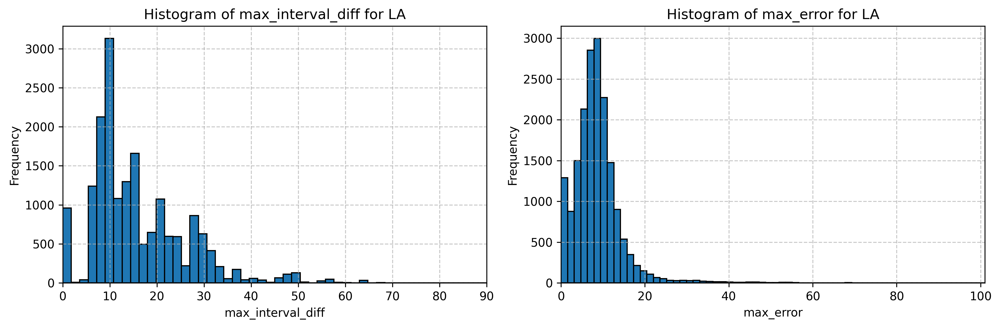

In [8]:
plot_max_diff(df_la_grouped, "LA")

# 4. Calculate Set of All Intervals

In [9]:
def calculate_error(val1, val2):
    diff = abs(val1 - val2)
    min_val = min(val1, val2)
    if min_val != 0:
        return diff * 100 / min_val
    if min_val == 0:
        if val1 == 0:
            return diff * 100 / val2
        if val2 == 0:
            return diff * 100 / val1
            
def calculate_intervals(input_tuple):
    # Filter out empty or single-element tuples.
    input_tuples = [t for t in input_tuple if len(t) > 1]
    
    if len(input_tuples) < 2:
        return None
        print(f"Short data: {input_tuple}")
    
    difference = [input_tuples[i + 1][0] - input_tuples[i][0] for i in range(len(input_tuples) - 1)]
    error = [calculate_error(input_tuples[i][1], input_tuples[i + 1][1]) for i in range(len(input_tuples) - 1)]
    
    if not difference:
        print(f"Empty data: {input_tuple}")
        return None
    return list(zip(difference, error))

def calculate_intervals_column(df_grouped):
    # Calculate maximum intervals.
    df_grouped["intervals"] = df_grouped["age_weight"].apply(calculate_intervals)
    return df_grouped

def explode_intervals(df):
    # Explode the list of tuples into separate rows.
    df_exploded = df.explode("intervals")
    
    # Create separate columns for each element in the tuple.
    df_exploded[["distance", "error"]] = pd.DataFrame(df_exploded["intervals"].tolist(), index=df_exploded.index)
    
    # Drop the original "col" column.
    df_exploded = df_exploded.drop(columns=["intervals"])
    return df_exploded

In [10]:
df_la_intervals = calculate_intervals_column(df_la_grouped)
df_la_intervals.head(3)

,specimen_id,age_weight,max_interval_diff,max_error,intervals
0,0000101b89855544bd766ac0b4455524,"[(371, 36.92), (371, 36.92), (375, 36.69), (38...",10.0,6.255380,"[(0, 0.0), (4, 0.6268738075770074), (10, 2.943..."
1,00005a60c9b3d3cb104516c3095ea2a8,"[(365, 34.78), (365, 34.78), (372, 34.72), (37...",9.0,10.376135,"[(0, 0.0), (7, 0.17281105990784065), (7, 0.748..."
2,0001fc391c7dfca9c188316a42f187e6,"[(367, 36.65), (370, 37.55), (380, 37.38), (38...",10.0,10.285883,"[(3, 2.455661664392902), (10, 0.45478865703583..."


In [11]:
df_la_exp = explode_intervals(df_la_intervals)
df_la_exp.head(3)

,specimen_id,age_weight,max_interval_diff,max_error,distance,error
0,0000101b89855544bd766ac0b4455524,"[(371, 36.92), (371, 36.92), (375, 36.69), (38...",10.0,6.25538,0.0,0.000000
0,0000101b89855544bd766ac0b4455524,"[(371, 36.92), (371, 36.92), (375, 36.69), (38...",10.0,6.25538,4.0,0.626874
0,0000101b89855544bd766ac0b4455524,"[(371, 36.92), (371, 36.92), (375, 36.69), (38...",10.0,6.25538,10.0,2.943581


# 5. Charts
## 5.1. Heatmap

In [12]:
def heatmap_intervals(df, life_stage, clip_size_x, clip_size_y, save=False):
    df = df[df["distance"] != 0]
    df["distance"] = df["distance"].clip(upper=clip_size_x)
    df["error"] = df["error"].clip(upper=clip_size_y-0.5)
    max_error = df["error"].max()
    
    fig = px.density_heatmap(df, x="distance", y="error", 
                             marginal_x="histogram", marginal_y="histogram", 
                             color_continuous_scale=[[0.0, "#023160"], 
                                                     [1.0, "#ffffff"]],
                             histfunc="count"
                            )
    fig.update_traces(marker=dict(color="#023160"), selector=dict(type="histogram"))

    # Set odd ticks on x-axis.
    max_distance = df["distance"].max()
    odd_x_ticks = [i for i in range(1, int(max_distance) + 1, 2)]
    fig.update_xaxes(tickvals=odd_x_ticks)
    
    # Force y-axis bins to start at 0 with 0.5 intervals.
    y_bins = np.arange(0, clip_size_y + 0.5, 0.5)
    fig.update_traces(
        ybins=dict(start=0, end=clip_size_y, size=0.5))
    
    # Set y-axis tick marks at 0.5 intervals.
    fig.update_yaxes(tickvals=y_bins, showgrid=True, gridwidth=0.5, gridcolor="lightgray")

    # Layout updates.
    fig.update_layout(
        title=f"Heatmap of Distance vs. Error for {life_stage}",
        xaxis_title="Distance, Days",
        yaxis_title="Error, %",
        width=800,
        height=800,
        template="simple_white",
    )
    
    if save:
        fig.write_image("heatmap_poster.png", format="png", scale=2)
        fig.write_image("heatmap_poster.svg", format="svg")
    fig.show()
    return 

heatmap_intervals(df=df_la_exp, life_stage="LA", clip_size_x=17, clip_size_y=15, save=True)

## 5.2. Boxplots

In [13]:
def boxplot_intervals(df, life_stage, max_dist=20):
    df = df[df["distance"] != 0]
    df["distance"] = df["distance"].astype(pd.Int64Dtype())
    error_counts = df.groupby("distance")["error"].count()
    
    df = df[df["distance"] <= max_dist]
    df = df[df["error"] < 100]
    
    sns.set(style="whitegrid", palette="pastel", color_codes=True)
    plt.figure(figsize=(8, 6), dpi=300)
    
    sns.boxplot(x="distance", y="error", data=df, linewidth=1.5)
    plt.show()
    return error_counts

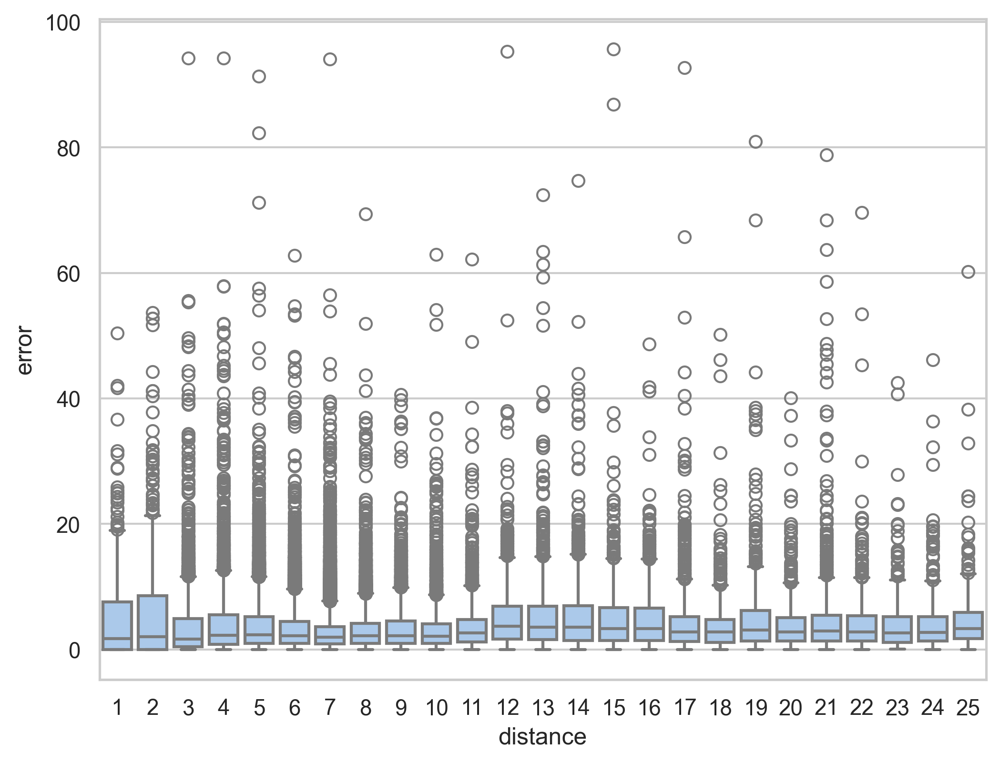

In [14]:
error_counts = boxplot_intervals(explode_intervals(df_la_intervals), "LA", max_dist=25)

In [15]:
def analyse_df(df):
    df_grouped = reshape_df(df, biogroup=True)
    df_intervals = calculate_intervals_column(df_grouped)
    df_explode = explode_intervals(df_intervals)
    return df_explode

In [16]:
def boxplot_intervals_grouped(df, life_stage, max_dist=35, crop=False):
    df = df[df["distance"] != 0]
    df["distance"] = df["distance"].astype(pd.Int64Dtype())
    
    # Group by distance and count the number of errors.
    error_counts = df.groupby("distance")["error"].count()
    
    # Filter the dataframe based on max_dist and error value.
    df = df[df["distance"] <= max_dist]
    df = df[df["error"] < 100]
    
    sns.set(style="whitegrid", palette="pastel", color_codes=True)
    
    plt.figure(figsize=(10, 6), dpi=300)
    
    # Plotting the boxplot with hue as the biological sample group and setting the hue order.
    boxplot = sns.boxplot(x="distance", y="error", hue="biological_sample_group", data=df, 
                          linewidth=1.5, hue_order=["control", "experimental"], palette="Set3")
    
    if crop:
        plt.ylim(0, 20)
    
    plt.title(f"Error Distribution by Distance for {life_stage}, max distance = {max_dist}", fontsize=16)
    plt.xlabel("Distance", fontsize=14)
    plt.ylabel("Error", fontsize=14)
    plt.yticks(fontsize=12)
    plt.grid(axis="y", linestyle="--", alpha=0.7)
    plt.tight_layout()

    # Move the legend outside of the plot.
    plt.legend(title="Biological Sample Group", bbox_to_anchor=(1.05, 1), loc="upper left", borderaxespad=0.)

    if crop:
        plt.savefig("crop.png", bbox_inches="tight")
    else:
        plt.savefig("all.png", bbox_inches="tight")

    plt.show()
    return error_counts

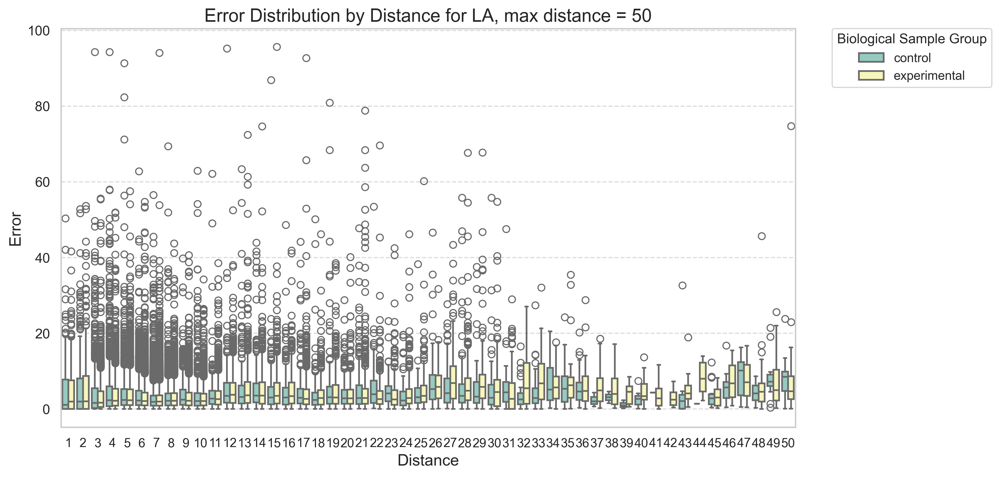

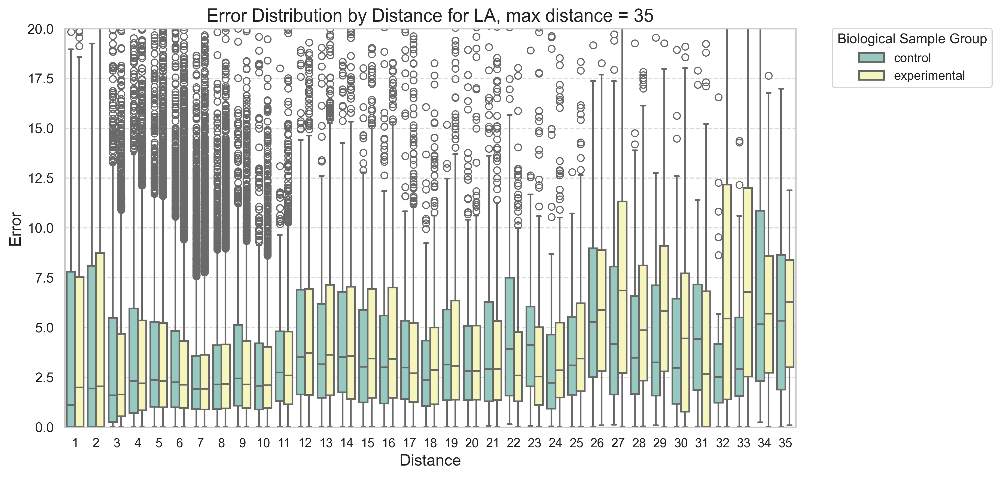

In [17]:
error_counts_la = boxplot_intervals_grouped(analyse_df(df_la_group), "LA", max_dist=50)
error_counts_la = boxplot_intervals_grouped(analyse_df(df_la_group), "LA", max_dist=35, crop=True)

## 5.3. Violin Plot

distance_group
1-5      37034
6-10     56534
11-15     9607
16-20     4911
21+       6122
Name: error, dtype: int64

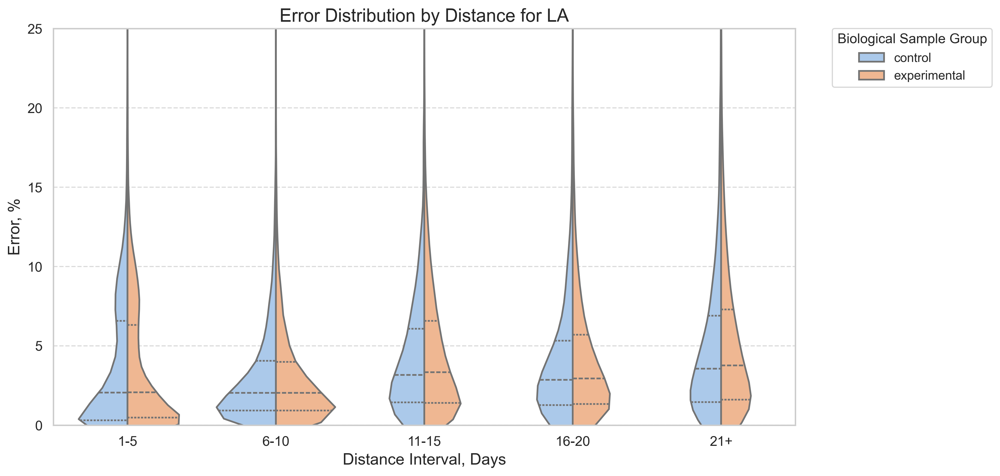

In [18]:
def violinplot_intervals_grouped(df, life_stage, max_dist=100, crop=True, save=False):
    # Ensure that the distance column has no zero values
    df = df[df["distance"] != 0]
    
    # Convert the distance column to an integer type
    df["distance"] = df["distance"].astype(pd.Int64Dtype())
    
    # Define custom bins and labels
    bins = [1, 5, 10, 15, 20, 100]  # Custom bin edges
    labels = ["1-5", "6-10", "11-15", "16-20", "21+"]
    
    # Assign distance values to bins.
    df["distance_group"] = pd.cut(df["distance"], bins=bins, labels=labels, right=True, include_lowest=True)
    
    # Drop NaN values from distance_group (if any).
    df = df.dropna(subset=["distance_group"])
    
    df = df[df["error"] < 100]
    
    sns.set(style="whitegrid", palette="pastel", color_codes=True)

    plt.figure(figsize=(10, 6), dpi=300)
    
    violinplot = sns.violinplot(x="distance_group", y="error", hue="biological_sample_group", data=df, 
                                linewidth=1.5, hue_order=["control", "experimental"],
                                inner="quart",
                                split=True,
                               )
    
    # Set y-axis limits.
    if crop:
        plt.ylim(0, 25)
    
    plt.title(f"Error Distribution by Distance for {life_stage}", fontsize=16)
    plt.xlabel("Distance Interval, Days", fontsize=14)
    plt.ylabel("Error, %", fontsize=14)
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    
    # Adding a horizontal grid for better readability.
    plt.grid(axis="y", linestyle="--", alpha=0.7)
    
    # Adding a tight layout to prevent overlapping labels.
    plt.tight_layout()
    
    # Move the legend outside of the plot.
    plt.legend(title="Biological Sample Group", bbox_to_anchor=(1.05, 1), loc="upper left", borderaxespad=0.)

    if save:
        plt.savefig("violin_plot.svg", format="svg", dpi=300)
    else:
        plt.show()
    
    return df.groupby("distance_group")["error"].count()

violinplot_intervals_grouped(analyse_df(df_la_group), "LA", max_dist=100, save=True)

# 5.4. Evaluate Consequences of the Change

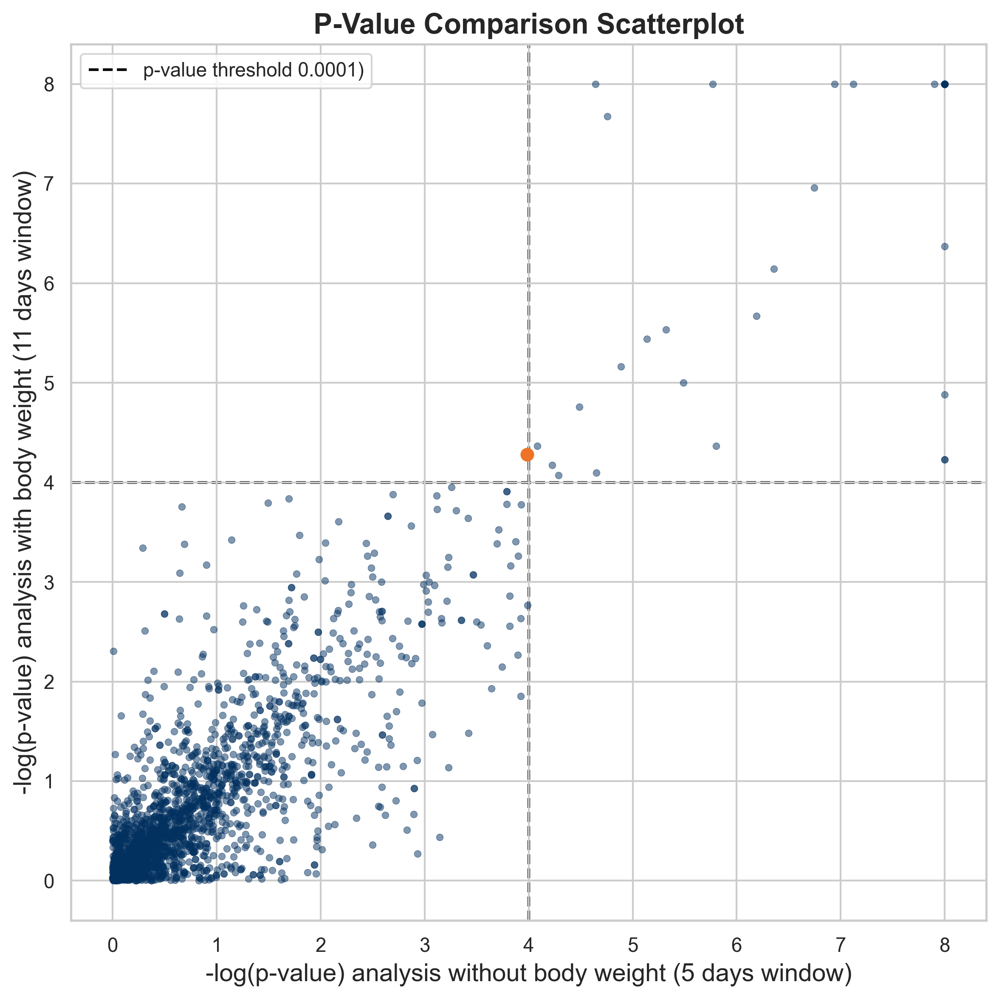

In [19]:
def plot_p_value_scatterplot(csv_file, save=False):
    # Load the data.
    df = pd.read_csv(csv_file)
    
    # Compute -log10 of p-values.
    df["-log10(dr21_p_value)"] = -np.log10(df["dr21_p_value"])
    df["-log10(p_value)"] = -np.log10(df["p_value"])
    
    # Clip values greater than 8.
    df["-log10(dr21_p_value)"] = df["-log10(dr21_p_value)"].clip(upper=8)
    df["-log10(p_value)"] = df["-log10(p_value)"].clip(upper=8)
    
    # Define significance threshold.
    threshold = -np.log10(0.0001)
    
    # Set up the plot.
    plt.figure(figsize=(8, 8), dpi=300)
    sns.set(style="whitegrid")
    
    # Define colors.
    default_color = "#023160"
    highlight_color = "#ee7326"
    
    # Identify points that satisfy conditions.
    highlight = (df["-log10(p_value)"] > 4) & (df["-log10(dr21_p_value)"] < 4)
    
    # Create scatterplot.
    ax = sns.scatterplot(
        x=df["-log10(dr21_p_value)"], 
        y=df["-log10(p_value)"], 
        edgecolor=default_color, 
        alpha=0.5,
        s=15,
        color=default_color
    )
    
    # Overlay highlighted points.
    sns.scatterplot(
        x=df.loc[highlight, "-log10(dr21_p_value)"], 
        y=df.loc[highlight, "-log10(p_value)"], 
        edgecolor=highlight_color, 
        s=50,
        alpha=1,
        color=highlight_color
    )
    
    # Draw significance thresholds.
    plt.axhline(y=threshold, color="black", linestyle="--", alpha = 1, label="p-value threshold 0.0001)", zorder=0)
    plt.axvline(x=threshold, color="black", linestyle="--", alpha = 1, label="", zorder=0)
    
    # Labels and title.
    plt.xlabel("-log(p-value) analysis without body weight (5 days window)", fontsize=14)
    plt.ylabel("-log(p-value) analysis with body weight (11 days window)", fontsize=14)
    plt.title("P-Value Comparison Scatterplot", fontsize=16, weight="bold")
    
    # Improve layout.
    plt.legend()
    plt.tight_layout()
    
    # Show the plot.
    if save:
        plt.savefig("poster_scatterplot.svg", format="svg", dpi=300)

plot_p_value_scatterplot("la_bwt_window_comparison.csv", save=True)